### Import Library

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.metrics import f1_score
import copy
import numpy as np
from sklearn.metrics import confusion_matrix
import itertools
import timm
from PIL import Image
import seaborn as sns
from collections import defaultdict
import random

### GPU Check

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device:{device}")

Using device:cuda


### Create Data

In [3]:
dataset_path = "/kaggle/input/animal-image-dataset-90-different-animals/animals/animals"
dataset = torchvision.datasets.ImageFolder(root=dataset_path)

In [4]:
print("Total images:", len(dataset))
print("Number of classes:", len(dataset.classes))
class_counts = Counter([label for _, label in dataset])
for idx, count in class_counts.items():
    print(f"Class '{dataset.classes[idx]}' has {count} images")

Total images: 5400
Number of classes: 90
Class 'antelope' has 60 images
Class 'badger' has 60 images
Class 'bat' has 60 images
Class 'bear' has 60 images
Class 'bee' has 60 images
Class 'beetle' has 60 images
Class 'bison' has 60 images
Class 'boar' has 60 images
Class 'butterfly' has 60 images
Class 'cat' has 60 images
Class 'caterpillar' has 60 images
Class 'chimpanzee' has 60 images
Class 'cockroach' has 60 images
Class 'cow' has 60 images
Class 'coyote' has 60 images
Class 'crab' has 60 images
Class 'crow' has 60 images
Class 'deer' has 60 images
Class 'dog' has 60 images
Class 'dolphin' has 60 images
Class 'donkey' has 60 images
Class 'dragonfly' has 60 images
Class 'duck' has 60 images
Class 'eagle' has 60 images
Class 'elephant' has 60 images
Class 'flamingo' has 60 images
Class 'fly' has 60 images
Class 'fox' has 60 images
Class 'goat' has 60 images
Class 'goldfish' has 60 images
Class 'goose' has 60 images
Class 'gorilla' has 60 images
Class 'grasshopper' has 60 images
Class '

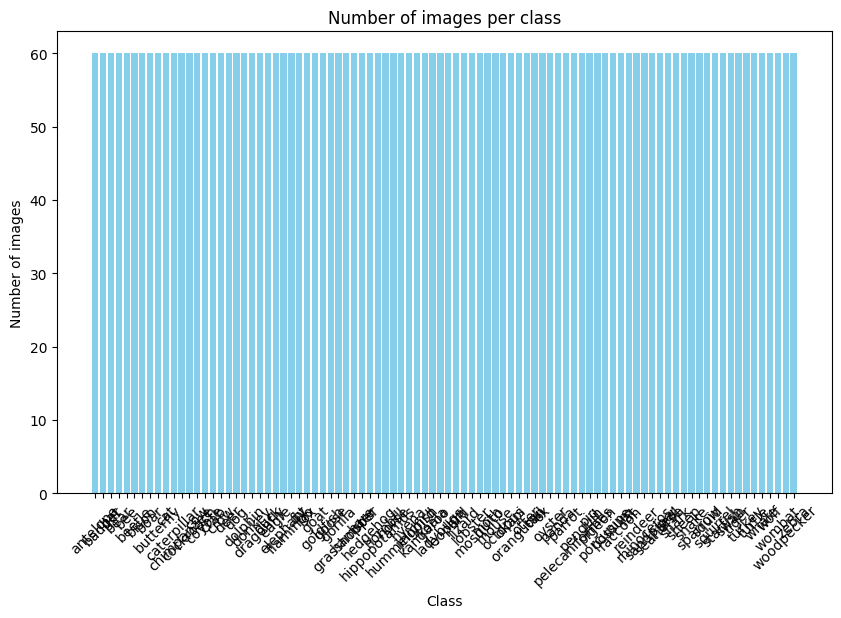

In [5]:
class_indices = [s[1] for s in dataset.samples]

counts = Counter(class_indices)

class_counts = [counts[i] for i in range(len(dataset.classes))]

plt.figure(figsize=(10, 6))
plt.bar(dataset.classes, class_counts, color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of images')
plt.title('Number of images per class')
plt.xticks(rotation=45)
plt.show()

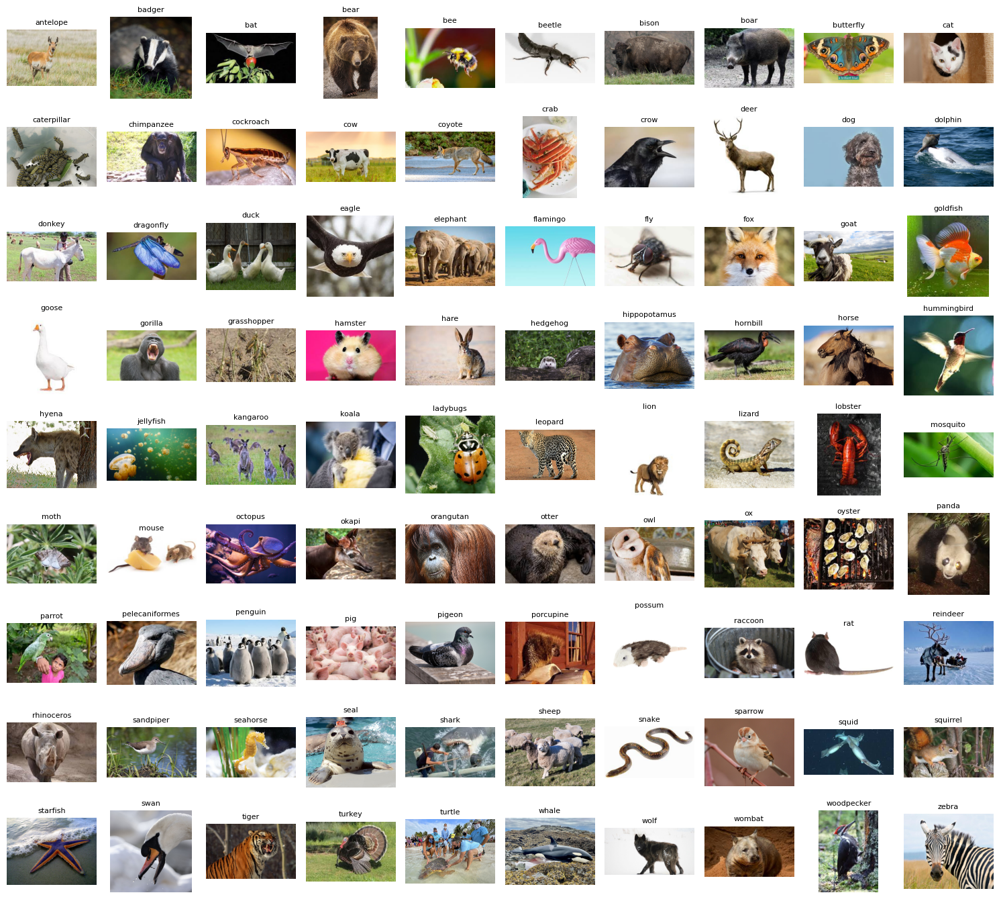

In [6]:
class_to_sample = {}
for filepath, label_idx in dataset.samples:
    class_name = dataset.classes[label_idx]
    if class_name not in class_to_sample:
        class_to_sample[class_name] = filepath

num_classes = len(dataset.classes)

cols = 10
rows = int(np.ceil(num_classes / cols))

fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(15, rows * 1.5),
                         subplot_kw={'xticks': [], 'yticks': []})

axes = axes.flatten()

for i, (class_name, filepath) in enumerate(class_to_sample.items()):
    image = plt.imread(filepath)
    axes[i].imshow(image)
    axes[i].set_title(class_name, fontsize=8)
    axes[i].axis('off')

for j in range(i+1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

### Set Data Transform

In [7]:
IMAGE_SIZE = 224

train_transforms = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                         std=[0.229, 0.224, 0.225])
])

val_transforms = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])


### Split Data

In [8]:
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

print("Train dataset size:", len(train_dataset))
print("Val dataset size:", len(val_dataset))

Train dataset size: 4320
Val dataset size: 1080


### Data Transformed

In [9]:
class TransformedDataset(torch.utils.data.Dataset):
    def __init__(self, subset, transform):
        self.subset = subset
        self.transform = transform
        self.loader = torchvision.datasets.folder.default_loader

    def __getitem__(self, index):
        path, label = self.subset.dataset.samples[self.subset.indices[index]]
        image = self.loader(path)
        image = self.transform(image)
        return image, label

    def __len__(self):
        return len(self.subset)

In [10]:
train_dataset = TransformedDataset(train_dataset, train_transforms)
val_dataset   = TransformedDataset(val_dataset, val_transforms)

### Create DataLoader

In [11]:
BATCH_SIZE = 32
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
val_loader   = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

### Crate Model

In [12]:
model_name = "efficientnet_b0"
model = timm.create_model(model_name, pretrained=True, num_classes=90)
model.to(device)

model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

EfficientNet(
  (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
  (bn1): BatchNormAct2d(
    32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
    (drop): Identity()
    (act): SiLU(inplace=True)
  )
  (blocks): Sequential(
    (0): Sequential(
      (0): DepthwiseSeparableConv(
        (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (bn1): BatchNormAct2d(
          32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
          (drop): Identity()
          (act): SiLU(inplace=True)
        )
        (aa): Identity()
        (se): SqueezeExcite(
          (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
          (act1): SiLU(inplace=True)
          (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
          (gate): Sigmoid()
        )
        (conv_pw): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn2

### Lost Function

In [13]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='max',
    factor=0.5,
    patience=2,
    verbose=True)

patience = 3
patience_counter = 0
best_val_f1 = 0.0
best_model_wts = copy.deepcopy(model.state_dict())

train_losses, train_accs = [], []
val_losses, val_accs, val_f1s = [], [], []

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


### Train One Epoch Function

In [14]:
def train_one_epoch(model, dataloader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for images, labels in dataloader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item() * images.size(0)
        _, predicted = torch.max(outputs, 1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)
        
    epoch_loss = running_loss / total
    epoch_acc = 100.0 * correct / total
    return epoch_loss, epoch_acc

### Evaluate Function (Loss, Accuracy and F1 Score)

In [15]:
def evaluate(model, dataloader, criterion, device):
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            
            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)
            
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            
    epoch_loss = running_loss / total
    epoch_acc = 100.0 * correct / total
    epoch_f1 = f1_score(all_labels, all_preds, average='weighted')
    return epoch_loss, epoch_acc, epoch_f1

### Model Train

In [16]:
NUM_EPOCHS = 30


for epoch in range(NUM_EPOCHS):
    train_loss, train_acc = train_one_epoch(model, train_loader, criterion, optimizer, device)
    val_loss, val_acc, val_f1 = evaluate(model, val_loader, criterion, device)
    
    train_losses.append(train_loss)
    train_accs.append(train_acc)
    val_losses.append(val_loss)
    val_accs.append(val_acc)
    val_f1s.append(val_f1)
    
    scheduler.step(val_f1)

    print(f"Epoch [{epoch+1}/{NUM_EPOCHS}]")
    print(f"  Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}%")
    print(f"  Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}% | Val F1: {val_f1:.4f}")

    if val_f1 > best_val_f1:
        best_val_f1 = val_f1
        best_model_wts = copy.deepcopy(model.state_dict())
        torch.save(model.state_dict(), "best_efficientnet2.pth")
        print("  Best model saved.")
        patience_counter = 0  # reset counter
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print("Early stopping triggered.")
        break

model.load_state_dict(best_model_wts)

Epoch [1/30]
  Train Loss: 1.6215 | Train Acc: 59.54%
  Val Loss: 0.7918 | Val Acc: 77.31% | Val F1: 0.7657
  Best model saved.
Epoch [2/30]
  Train Loss: 0.4726 | Train Acc: 86.48%
  Val Loss: 0.7291 | Val Acc: 79.81% | Val F1: 0.8009
  Best model saved.
Epoch [3/30]
  Train Loss: 0.2698 | Train Acc: 92.38%
  Val Loss: 0.7080 | Val Acc: 81.85% | Val F1: 0.8146
  Best model saved.
Epoch [4/30]
  Train Loss: 0.1998 | Train Acc: 94.26%
  Val Loss: 0.6363 | Val Acc: 84.44% | Val F1: 0.8433
  Best model saved.
Epoch [5/30]
  Train Loss: 0.1541 | Train Acc: 95.67%
  Val Loss: 0.5633 | Val Acc: 85.00% | Val F1: 0.8523
  Best model saved.
Epoch [6/30]
  Train Loss: 0.1718 | Train Acc: 94.84%
  Val Loss: 0.6862 | Val Acc: 83.89% | Val F1: 0.8396
Epoch [7/30]
  Train Loss: 0.2334 | Train Acc: 92.82%
  Val Loss: 0.9058 | Val Acc: 80.09% | Val F1: 0.7993
Epoch [8/30]
  Train Loss: 0.1898 | Train Acc: 94.56%
  Val Loss: 0.8153 | Val Acc: 81.48% | Val F1: 0.8171
Early stopping triggered.


<All keys matched successfully>

### Graph

In [17]:
epochs_range = range(1, len(train_losses) + 1)
plt.figure(figsize=(18,5))

<Figure size 1800x500 with 0 Axes>

<Figure size 1800x500 with 0 Axes>

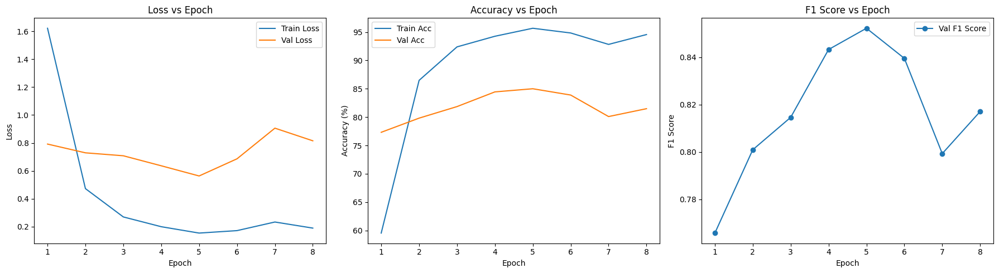

In [18]:
plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
plt.plot(epochs_range, train_losses, label="Train Loss")
plt.plot(epochs_range, val_losses, label="Val Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs Epoch")
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(epochs_range, train_accs, label="Train Acc")
plt.plot(epochs_range, val_accs, label="Val Acc")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.title("Accuracy vs Epoch")
plt.legend()

plt.subplot(1, 3, 3)
plt.plot(epochs_range, val_f1s, label="Val F1 Score", marker='o')
plt.xlabel("Epoch")
plt.ylabel("F1 Score")
plt.title("F1 Score vs Epoch")
plt.legend()

plt.tight_layout()
plt.show()

### Confusion Matrix

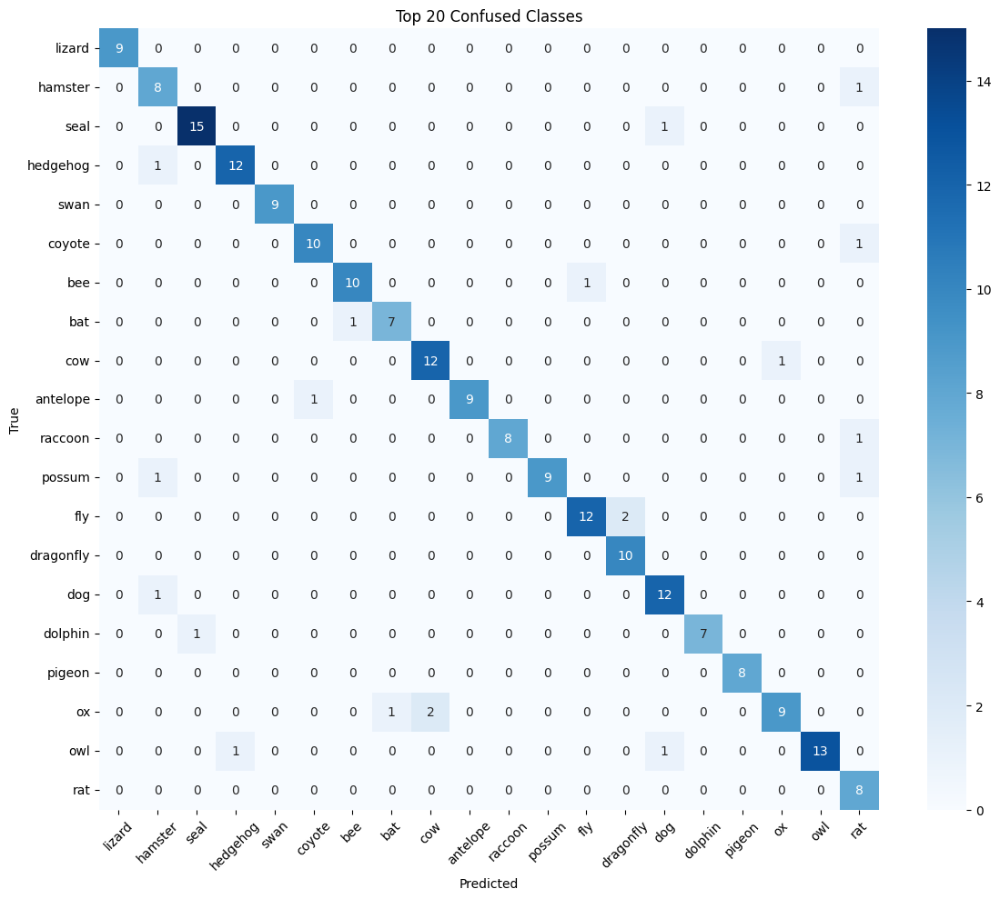

In [21]:
all_preds = []
all_labels = []
model.eval()

with torch.no_grad():
    for images, labels in val_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

cm = confusion_matrix(all_labels, all_preds)

classes = dataset.classes

errors = cm.sum(axis=1) - np.diag(cm)

top_n = 20
top_n_idx = np.argsort(errors)[-top_n:]

cm_top = cm[top_n_idx][:, top_n_idx]
classes_top = [classes[i] for i in top_n_idx]

plt.figure(figsize=(12, 10))
sns.heatmap(cm_top, annot=True, fmt='d', cmap='Blues',
            xticklabels=classes_top, yticklabels=classes_top)
plt.title("Top 20 Confused Classes")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

### Predicted Validation

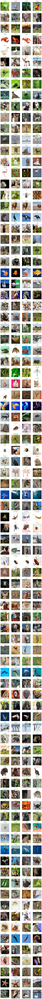

In [24]:
class_to_indices = defaultdict(list)
for idx in range(len(val_dataset)):
    _, label = val_dataset[idx]
    class_to_indices[label].append(idx)

samples_per_class = 4
selected_classes = [k for k, v in class_to_indices.items() if len(v) >= samples_per_class]

num_classes_to_show = len(selected_classes)
rows = num_classes_to_show
cols = samples_per_class

fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2),
                         subplot_kw={'xticks': [], 'yticks': []})

if rows == 1:
    axes = [axes]

for row_idx, class_idx in enumerate(selected_classes):
    sampled_indices = random.sample(class_to_indices[class_idx], samples_per_class)
    
    for col_idx, sample_idx in enumerate(sampled_indices):
        image, label = val_dataset[sample_idx]
        image_tensor = image.unsqueeze(0).to(device)

        outputs = model(image_tensor)
        _, pred = torch.max(outputs, 1)
        pred = pred.item()

        image_np = image.cpu().numpy().transpose((1, 2, 0))
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image_np = std * image_np + mean
        image_np = np.clip(image_np, 0, 1)

        ax = axes[row_idx][col_idx] if rows > 1 else axes[col_idx]
        ax.imshow(image_np)

        color = 'green' if pred == label else 'red'
        true_label = dataset.classes[label]
        pred_label = dataset.classes[pred]

        ax.set_title(f"T: {true_label}\nP: {pred_label}", color=color, fontsize=8)
        ax.axis('off')

plt.tight_layout()
plt.show()